In [1]:
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import pprint
import json
import tqdm
import os

In [2]:
class ZindDataset(Dataset):
    def __init__(self, data_path, size=1575):
        self.data_path = data_path
        self.data = []
        
        for i in tqdm.tqdm(range(size)):
            dir_path = os.path.join(data_path, f"{i:04d}")

            floor_plans = []
            panos = []
            room_layout = None
            
            floor_plans_path = os.path.join(dir_path, "floor_plans")
            panos_path = os.path.join(dir_path, "panos")
            room_layout_json_path = os.path.join(dir_path, "zind_data.json")

            with open(room_layout_json_path, "r") as f:
                room_layout = json.load(f)
            
            # for floor_plan_file in tqdm.tqdm(os.listdir(floor_plans_path)):
            for floor_plan_file in os.listdir(floor_plans_path):
                floor_plan_path = os.path.join(floor_plans_path, floor_plan_file)
                floor_plan_img = Image.open(floor_plan_path)
                floor_plans.append(floor_plan_img)

            # for pano_file in tqdm.tqdm(os.listdir(panos_path)):
            for pano_file in os.listdir(panos_path):
                pano_path = os.path.join(panos_path, pano_file)
                pano_img = Image.open(pano_path)
                panos.append(pano_img)

            self.data.append({
                "id": i,
                "floor_plans": floor_plans,
                "panos": panos,
                "room_layout": room_layout,
            })

    def __getitem__(self, index):
        return self.data[index]

    def __len__(self):
        return len(self.data)

In [3]:
zind_path = "../data/zillow/zind/data"
dataset = ZindDataset(zind_path)

100%|██████████| 1575/1575 [00:17<00:00, 92.43it/s] 


Dataset size: 1575
Item id:  0


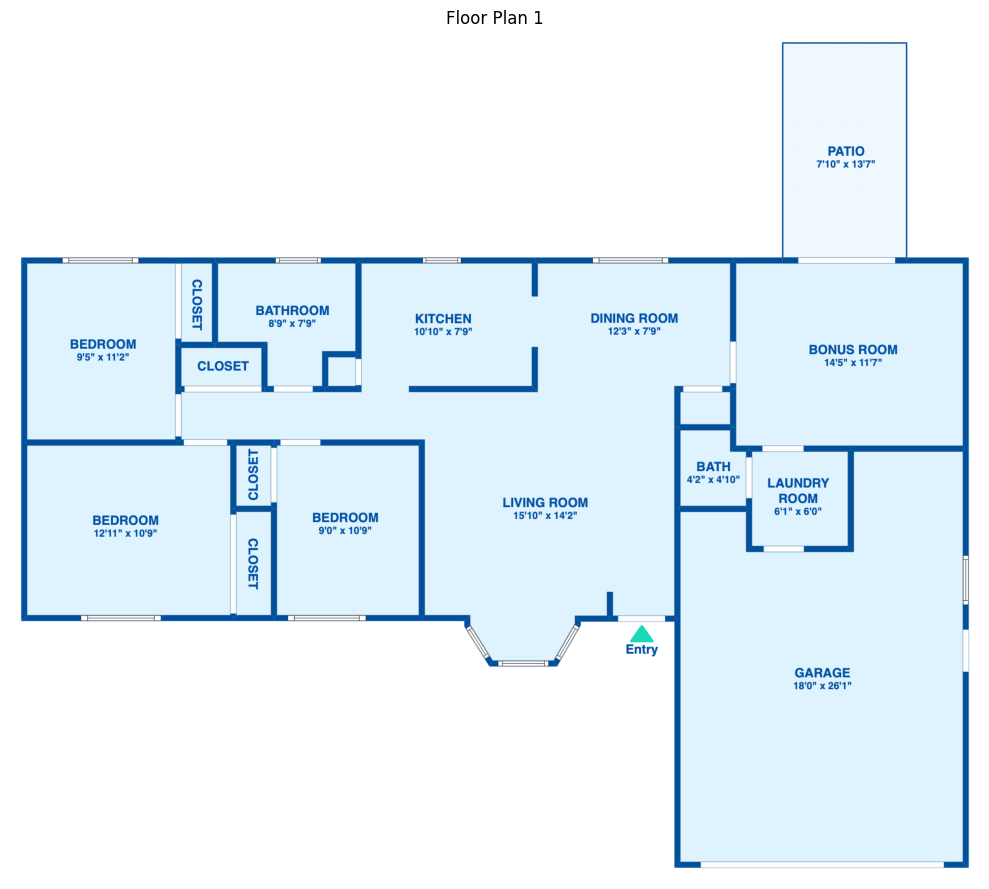

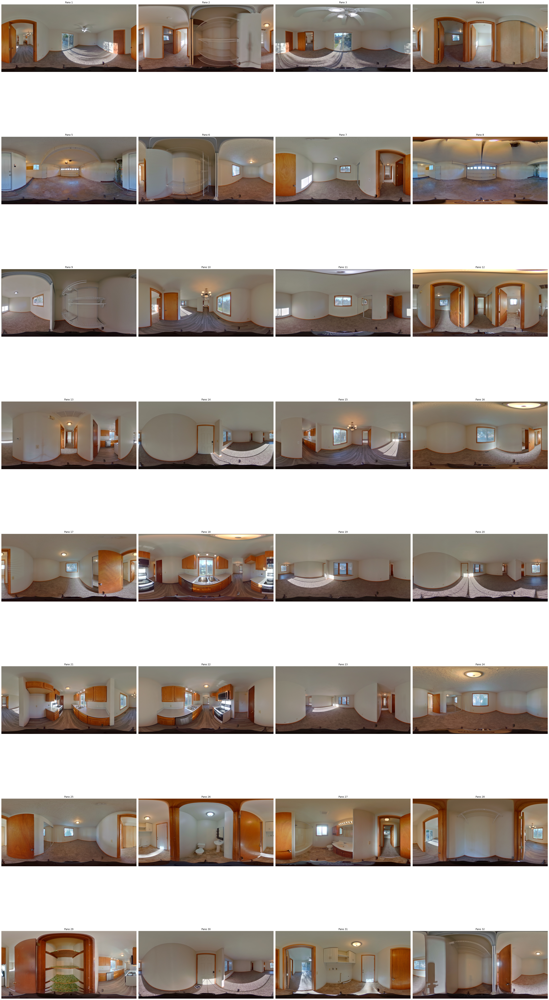

In [5]:
print("Dataset size:", len(dataset))

item = dataset[0]
print("Item id: ", item["id"])
room_layout = item["room_layout"]
# pprint.pprint(room_layout)
floor_plans = item["floor_plans"]
panos = item["panos"]

n_floor_plans = len(floor_plans)
fig, axes = plt.subplots(1, n_floor_plans, figsize=(10*n_floor_plans, 10))
if n_floor_plans == 1:
    axes = [axes]
for i, (ax, floor_plan) in enumerate(zip(axes, floor_plans)):
    ax.imshow(floor_plan)
    ax.set_title(f'Floor Plan {i+1}')
    ax.axis('off')
plt.tight_layout()
plt.show()

n_panos = len(panos)
n_cols = 4  # Display 4 panos per row
n_rows = (n_panos + n_cols - 1) // n_cols  # Ceiling division to get number of rows needed

fig, axes = plt.subplots(n_rows, n_cols, figsize=(40, 10*n_rows))
if n_rows == 1 and n_cols == 1:
    axes = np.array([[axes]])
elif n_rows == 1:
    axes = axes.reshape(1, -1)
elif n_cols == 1:
    axes = axes.reshape(-1, 1)

for i in range(n_rows * n_cols):
    row = i // n_cols
    col = i % n_cols
    if i < n_panos:
        axes[row, col].imshow(panos[i])
        axes[row, col].set_title(f'Pano {i+1}')
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()